# 1.크롤링

In [4]:
#selenium 설치

#conda install selenium

Solving environment: ...working... done

## Package Plan ##

  environment location: C:\Users\chose\anaconda3

  added / updated specs:
    - selenium


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    conda-4.13.0               |   py39haa95532_0         923 KB
    selenium-3.141.0           |py39h2bbff1b_1000         815 KB
    ------------------------------------------------------------
                                           Total:         1.7 MB

The following NEW packages will be INSTALLED:

  selenium           pkgs/main/win-64::selenium-3.141.0-py39h2bbff1b_1000

The following packages will be UPDATED:

  conda                               4.10.3-py39haa95532_0 --> 4.13.0-py39haa95532_0




conda-4.13.0         | 923 KB    |            |   0% 
conda-4.13.0         | 923 KB    | #2         |  12% 
conda-4.13.0         | 923 KB    | ####1      |  42% 
conda-4.13.0         | 923 

In [1]:
import pandas as pd

In [12]:
pip install msedge-selenium-tools selenium==3.141

Note: you may need to restart the kernel to use updated packages.


In [98]:
#최종1
from msedge.selenium_tools import Edge, EdgeOptions
from selenium import webdriver
from selenium.webdriver.common.by import By
from selenium.webdriver.common.keys import Keys
from selenium.webdriver import ActionChains
import time
import pandas as pd

options = EdgeOptions()
options.use_chromium = True
options.add_argument('--no-sandbox')
options.add_argument('--disable-dev-shm-usage')

driver = Edge('C:/Users/chose/Desktop/HeySolux/edgedriver_win64/msedgedriver', options=options)
driver.maximize_window()

action = ActionChains(driver)

C:\Users\chose\AppData\Local\Temp/ipykernel_4760/645185793.py:15: DeprecationWarning: Selenium Tools for Microsoft Edge is deprecated. Please upgrade to Selenium 4 which has built-in support for Microsoft Edge (Chromium): https://docs.microsoft.com/en-us/microsoft-edge/webdriver-chromium/#upgrading-from-selenium-3
  driver = Edge('C:/Users/chose/Desktop/HeySolux/edgedriver_win64/msedgedriver', options=options)


In [110]:
#최종2-2
#더보기 안 함. 각 페이지 url 리스트 만듦

sample = [('sample','sample','sample')]
df = pd.DataFrame(sample,columns=['hotelName','rating','review'])
k = 1
n = 300

while True:     
    #트립어드바이저 서울 호텔 
    url='https://www.tripadvisor.co.kr/Hotels-g294197-oa'+str(n)+'-Seoul-Hotels.html'
    driver.get(url)
    
    #각 페이지마다 호텔 리스트 얻기
    hotelList = driver.find_elements(By.CSS_SELECTOR, ".property_title.prominent")
    time.sleep(3)
                
    #호텔 클릭해서 들어가기
    for j in range(0, len(hotelList)):
            #로딩 대기
            time.sleep(1)
            #첫번째 호텔이면 맨 위로 스크롤
            if(j==0):
                #driver.execute_script('window.scrollTo(0,0)')
                driver.execute_script('arguments[0].scrollIntoView(true);', hotelList[0])
                location = driver.execute_script("return window.pageYOffset")
                driver.execute_script("window.scrollTo(0,{})".format(location -300))
 
            #하나 앞의 호텔의 위치까지 스크롤
            else:
                driver.execute_script('arguments[0].scrollIntoView(true);', hotelList[j-1])

            #호텔 클릭
            hotelList[j].click()
            #열린 새 탭으로 전환
            driver.switch_to.window(driver.window_handles[1])
            #호텔 이름
            hotelName = driver.find_element("id", "HEADING").text
            #print(hotelName)
            
            page = 0
            while True:
                page += 1
                #로딩 대기
                time.sleep(3)

                #평점과 리뷰를 모두 담은 컨테이너
                #리스트 형태
                reviews = driver.find_elements(By.CSS_SELECTOR, ".WAllg._T")
                if(len(reviews) == 0):
                    break

                #첫번째 리뷰 위치로 스크롤
                driver.execute_script('arguments[0].scrollIntoView(true);', reviews[0])

                #리뷰 페이지 바뀔때마다
                #'더보기' 버튼 클릭
                time.sleep(3)
                expand_review = driver.find_elements(By.CSS_SELECTOR, ".Ignyf._S.Z")[0]
                expand_review.click()

                #리뷰 한 페이지 크롤링
                for i in range(0, len(reviews)):
                    #리뷰 가져오기
                    temp_review = reviews[i].find_elements(By.CSS_SELECTOR, ".QewHA.H4")[0].text
                    review = temp_review.replace("\n"," ")
                    #print(review)

                    #평점 가져오기
                    rating_code = reviews[i].find_element(By.CSS_SELECTOR, ".ui_bubble_rating")
                    cls_attr = rating_code.get_attribute("class")
                    cls_attr = str(cls_attr).split("ui_bubble_rating bubble_")
                    rating = int(cls_attr[1][0])
                    #print(rating)

                    #print('\n')
                    df.loc[k] = [hotelName, rating, review]
                    k += 1
                #다음 페이지 있는지 확인. 있다면 다음 버튼 클릭하여 다시 크롤링 반복
                next_review = driver.find_elements(By.CSS_SELECTOR, ".ui_button.nav.next.primary ")
                if(len(next_review)!=0):
                    next_review_btn = driver.find_elements(By.CSS_SELECTOR, ".ui_button.nav.next.primary ")[0]
                    next_review_btn_state = next_review_btn.get_attribute("class").split(" ")[-1]

                    if(next_review_btn_state == "disabled" or page==20):
                        break
                    else:
                        next_review_btn.click()
                else:
                    break



            #한 호텔에 대한 리뷰 크롤링 완료
            #탭 닫기
            driver.close()
            #첫번째 탭으로 전환
            driver.switch_to.window(driver.window_handles[0])
    n += 30
    #다음 페이지 있는지 확인. 있다면 다음 버튼 클릭.
#     next_btn = driver.find_element(By.CSS_SELECTOR, ".nav.next.ui_button.primary")
#     next_btn_state = next_btn.get_attribute("class").split(" ")[-1]

#     if(next_btn_state == "disabled"):
#         break
#     else:
#         next_btn.click()


StaleElementReferenceException: Message: stale element reference: element is not attached to the page document
  (Session info: MicrosoftEdge=103.0.1264.71)


In [130]:
pd.read_csv("data.csv")

,hotelName,rating,review
0,포포인츠 바이 쉐라톤 서울역,3,"set79,c○m set79,c○m set79,c○m ←←←←←←← ♪☞〉♪▣▷♩◆..."
1,포포인츠 바이 쉐라톤 서울역,3,nbs16*cㅇm nbs16*cㅇm nbs16*cㅇm ←←←←←←← ★☏○〕』▼＠◁...
2,포포인츠 바이 쉐라톤 서울역,3,hfm96*c0m hfm96*c0m hfm96*c0m ←←←←←←← ▷』▲〈α★▽◇...
3,포포인츠 바이 쉐라톤 서울역,2,베트남에서묵어보고좋아서한국에서또예약했는데방에들어가자마자실망이었네요 이불위에머리카락있...
4,포포인츠 바이 쉐라톤 서울역,5,호텔 시설과 객실의 관리 상태는 매우 좋습니다. 침대도 사치품은 아니지만 편하게 자...
...,...,...,...
17398,라온 게스트하우스,5,남편과 나는 이 곳에서 1박 하는 것입니다. 주인은 아주 친절하고 도움이 되었습니다...
17399,라온 게스트하우스,5,우리는 밤 늦게 체크인을 해 주는 친절한 주인이 특별 할인. 경험하고 싶다면 완벽한...
17400,라온 게스트하우스,5,"놀라운 위치한 라온 게스트하우스 - 서울의 한 가운데에, 경복궁 바로 옆. 주인들은..."
17401,라온 게스트하우스,4,"수백 년 된 오래된 전통 가옥 이 궁전에 ""경복궁"". 주인도 매우 친절하고 제공된 ..."


# 2. 전처리

In [1]:
import pandas as pd

In [2]:
df = pd.read_csv("data.csv")
df

,hotelName,rating,review
0,포포인츠 바이 쉐라톤 서울역,3,"set79,c○m set79,c○m set79,c○m ←←←←←←← ♪☞〉♪▣▷♩◆..."
1,포포인츠 바이 쉐라톤 서울역,3,nbs16*cㅇm nbs16*cㅇm nbs16*cㅇm ←←←←←←← ★☏○〕』▼＠◁...
2,포포인츠 바이 쉐라톤 서울역,3,hfm96*c0m hfm96*c0m hfm96*c0m ←←←←←←← ▷』▲〈α★▽◇...
3,포포인츠 바이 쉐라톤 서울역,2,베트남에서묵어보고좋아서한국에서또예약했는데방에들어가자마자실망이었네요 이불위에머리카락있...
4,포포인츠 바이 쉐라톤 서울역,5,호텔 시설과 객실의 관리 상태는 매우 좋습니다. 침대도 사치품은 아니지만 편하게 자...
...,...,...,...
17398,라온 게스트하우스,5,남편과 나는 이 곳에서 1박 하는 것입니다. 주인은 아주 친절하고 도움이 되었습니다...
17399,라온 게스트하우스,5,우리는 밤 늦게 체크인을 해 주는 친절한 주인이 특별 할인. 경험하고 싶다면 완벽한...
17400,라온 게스트하우스,5,"놀라운 위치한 라온 게스트하우스 - 서울의 한 가운데에, 경복궁 바로 옆. 주인들은..."
17401,라온 게스트하우스,4,"수백 년 된 오래된 전통 가옥 이 궁전에 ""경복궁"". 주인도 매우 친절하고 제공된 ..."


In [3]:
df.shape

(17403, 3)

In [4]:
df.isnull().sum()

hotelName    0
rating       0
review       0
dtype: int64

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17403 entries, 0 to 17402
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   hotelName  17403 non-null  object
 1   rating     17403 non-null  object
 2   review     17403 non-null  object
dtypes: object(3)
memory usage: 408.0+ KB


In [6]:
df['review'][10]

'서울역과 지하도로 바로 연결되어 있어서 공항, 기차, 지하철 접근이 아주 용이합니다. 전반적으로 직원들의 대응 및 서비스가 훌륭하며, 욕조가 제공되는 디럭스룸의 경우 동급 비즈니스 호텔과 비교해도 비교적 넓은편입니다. 전망은 서울역 방면이 더 좋으나 기차 소리가 올라올수 있으며, 용산 도심 방면 역시 기차 소리가 들리는 위치상의 한계가 있습니다. 남산 및 기타 방면의 경우 옆 인접 오피스텔들 커텐 개방 시 프라이빗이 침범할 수 있습니다. 이용객들이 많는 찾는 호텔이다보니 일부 룸의 경우 객실 및 청소 상태가 미비한 경우도 있습니다. 조식은 동급 호텔과 비교하여도 상당히 훌륭한 편이면 주말의 경우 이용객이 많아 조금 서두르는 것이 좋습니다.'

## 2-1. 정규 표현식 적용

In [4]:
import konlpy

In [6]:
#정규 표현식 함수 정의
import re

def apply_regular_expression(text):
    hangul = re.compile('[^ ㄱ-ㅣ 가-힣]')  # 한글 추출 규칙: 띄어 쓰기(1 개)를 포함한 한글
    result = hangul.sub('', text)  # 위에 설정한 "hangul"규칙을 "text"에 적용(.sub)시킴
    return result

In [9]:
df['review'][3]

'베트남에서묵어보고좋아서한국에서또예약했는데방에들어가자마자실망이었네요 이불위에머리카락있고서울역에서위치도너무멀고.. 여행객들이큰가방들고왔다갔다하기너무불편해요 그리고분실물도제가전화해서찾아달라그랬네여 청소하다가분실물이있음우리한테알려줘야하는거아닌가요?'

In [10]:
apply_regular_expression(df['review'][3])

'베트남에서묵어보고좋아서한국에서또예약했는데방에들어가자마자실망이었네요 이불위에머리카락있고서울역에서위치도너무멀고 여행객들이큰가방들고왔다갔다하기너무불편해요 그리고분실물도제가전화해서찾아달라그랬네여 청소하다가분실물이있음우리한테알려줘야하는거아닌가요'

In [11]:
#df 데이터프레임 복사
test_df = df.copy()
test_df

,hotelName,rating,review
0,포포인츠 바이 쉐라톤 서울역,3,"set79,c○m set79,c○m set79,c○m ←←←←←←← ♪☞〉♪▣▷♩◆..."
1,포포인츠 바이 쉐라톤 서울역,3,nbs16*cㅇm nbs16*cㅇm nbs16*cㅇm ←←←←←←← ★☏○〕』▼＠◁...
2,포포인츠 바이 쉐라톤 서울역,3,hfm96*c0m hfm96*c0m hfm96*c0m ←←←←←←← ▷』▲〈α★▽◇...
3,포포인츠 바이 쉐라톤 서울역,2,베트남에서묵어보고좋아서한국에서또예약했는데방에들어가자마자실망이었네요 이불위에머리카락있...
4,포포인츠 바이 쉐라톤 서울역,5,호텔 시설과 객실의 관리 상태는 매우 좋습니다. 침대도 사치품은 아니지만 편하게 자...
...,...,...,...
17398,라온 게스트하우스,5,남편과 나는 이 곳에서 1박 하는 것입니다. 주인은 아주 친절하고 도움이 되었습니다...
17399,라온 게스트하우스,5,우리는 밤 늦게 체크인을 해 주는 친절한 주인이 특별 할인. 경험하고 싶다면 완벽한...
17400,라온 게스트하우스,5,"놀라운 위치한 라온 게스트하우스 - 서울의 한 가운데에, 경복궁 바로 옆. 주인들은..."
17401,라온 게스트하우스,4,"수백 년 된 오래된 전통 가옥 이 궁전에 ""경복궁"". 주인도 매우 친절하고 제공된 ..."


In [12]:
# 전체 리뷰에 적용
test_df['review'] = test_df['review'].apply(apply_regular_expression)

In [13]:
test_df

,hotelName,rating,review
0,포포인츠 바이 쉐라톤 서울역,3,배팅 제한 없는 경마사이트 고액배터 환영 고액출금 분안에 진행 박진감 넘치...
1,포포인츠 바이 쉐라톤 서울역,3,ㅇ ㅇ ㅇ 입출금 보장되고 배팅제한 없는사이트에서 맘껏 즐기다 가세요 업계대 카...
2,포포인츠 바이 쉐라톤 서울역,3,입출금 보장되고 배팅제한 없는사이트에서 맘껏 즐기다 가세요 업계대 카지노사...
3,포포인츠 바이 쉐라톤 서울역,2,베트남에서묵어보고좋아서한국에서또예약했는데방에들어가자마자실망이었네요 이불위에머리카락있...
4,포포인츠 바이 쉐라톤 서울역,5,호텔 시설과 객실의 관리 상태는 매우 좋습니다 침대도 사치품은 아니지만 편하게 자는...
...,...,...,...
17398,라온 게스트하우스,5,남편과 나는 이 곳에서 박 하는 것입니다 주인은 아주 친절하고 도움이 되었습니다 좋...
17399,라온 게스트하우스,5,우리는 밤 늦게 체크인을 해 주는 친절한 주인이 특별 할인 경험하고 싶다면 완벽한 ...
17400,라온 게스트하우스,5,놀라운 위치한 라온 게스트하우스 서울의 한 가운데에 경복궁 바로 옆 주인들은 아주...
17401,라온 게스트하우스,4,수백 년 된 오래된 전통 가옥 이 궁전에 경복궁 주인도 매우 친절하고 제공된 빵 잼...


## 2-2. review 중 스팸 글 제거

In [14]:
#'경마',  '배팅' 단어 포함하는 행
word_list = ['경마', '배팅']
test = '|'.join(word_list)
a = test_df[test_df['review'].str.contains(test)]
a

,hotelName,rating,review
0,포포인츠 바이 쉐라톤 서울역,3,배팅 제한 없는 경마사이트 고액배터 환영 고액출금 분안에 진행 박진감 넘치...
1,포포인츠 바이 쉐라톤 서울역,3,ㅇ ㅇ ㅇ 입출금 보장되고 배팅제한 없는사이트에서 맘껏 즐기다 가세요 업계대 카...
2,포포인츠 바이 쉐라톤 서울역,3,입출금 보장되고 배팅제한 없는사이트에서 맘껏 즐기다 가세요 업계대 카지노사...
245,롯데 시티 호텔 명동,3,입출금 보장되고 배팅제한 없는사이트에서 맘껏 즐기다 가세요 업계대 카지노...
446,스위스 그랜드 호텔,3,입출금 보장되고 배팅제한 없는사이트에서 맘껏 즐기다 가세요 업계대 카지노...
448,스위스 그랜드 호텔,3,입출금 보장되고 배팅제한 없는사이트에서 맘껏 즐기다 가세요 업계대 카지노...
962,라마다 서울 동대문,3,입출금 보장되고 배팅제한 없는사이트에서 맘껏 즐기다 가세요 업계대 카지노...
963,라마다 서울 동대문,3,배팅 제한 없는 경마사이트 고액배터 환영 고액출금 분안에 진행 박진감 넘...
2469,코트야드 메리어트 서울 타임스퀘어,3,배팅 제한 없는 경마사이트 고액배터 환영 고액출금 분안에 진행 박진감 넘...
3903,코트야드 메리어트 서울 타임스퀘어,3,배팅 제한 없는 경마사이트 고액배터 환영 고액출금 분안에 진행 박진감 넘...


In [15]:
a.shape

(48, 3)

In [16]:
a.index

Int64Index([    0,     1,     2,   245,   446,   448,   962,   963,  2469,
             3903,  4003,  5706,  5707,  5708,  5709,  5710,  6641,  6642,
             6842,  6843,  7139,  7143,  7394,  7790,  8469,  8470,  8566,
             8570,  8667,  8766,  9590, 10445, 10840, 11039, 11040, 11503,
            11505, 11506, 11917, 11919, 11920, 12347, 12349, 12497, 12498,
            12556, 12557, 14067],
           dtype='int64')

In [17]:
#'경마',  '배팅' 단어 포함하는 행 제거
df = df.drop(index = a.index)

In [18]:
#최종 데이터셋 df
df

,hotelName,rating,review
3,포포인츠 바이 쉐라톤 서울역,2,베트남에서묵어보고좋아서한국에서또예약했는데방에들어가자마자실망이었네요 이불위에머리카락있...
4,포포인츠 바이 쉐라톤 서울역,5,호텔 시설과 객실의 관리 상태는 매우 좋습니다. 침대도 사치품은 아니지만 편하게 자...
5,포포인츠 바이 쉐라톤 서울역,1,비지니스 일정으로 평일에 투숙하였습니다. 호텔의 시설이나 직원의 서비스를 평가하기...
6,포포인츠 바이 쉐라톤 서울역,1,이 호텔은 수준은 그냥 동네 모텔 수준 입이다 1.방에 먼저 엄청 많아요 2.노후...
7,포포인츠 바이 쉐라톤 서울역,3,총점 70점 로비 첫인상은 클래식한 느낌 나쁘진않음 엘레베이터는 빠르고 잘되어있음...
...,...,...,...
17398,라온 게스트하우스,5,남편과 나는 이 곳에서 1박 하는 것입니다. 주인은 아주 친절하고 도움이 되었습니다...
17399,라온 게스트하우스,5,우리는 밤 늦게 체크인을 해 주는 친절한 주인이 특별 할인. 경험하고 싶다면 완벽한...
17400,라온 게스트하우스,5,"놀라운 위치한 라온 게스트하우스 - 서울의 한 가운데에, 경복궁 바로 옆. 주인들은..."
17401,라온 게스트하우스,4,"수백 년 된 오래된 전통 가옥 이 궁전에 ""경복궁"". 주인도 매우 친절하고 제공된 ..."


In [10]:
df = pd.read_csv("data2.csv")
df

,hotelName,rating,review
0,포포인츠 바이 쉐라톤 서울역,2,베트남에서묵어보고좋아서한국에서또예약했는데방에들어가자마자실망이었네요 이불위에머리카락있...
1,포포인츠 바이 쉐라톤 서울역,5,호텔 시설과 객실의 관리 상태는 매우 좋습니다. 침대도 사치품은 아니지만 편하게 자...
2,포포인츠 바이 쉐라톤 서울역,1,비지니스 일정으로 평일에 투숙하였습니다. 호텔의 시설이나 직원의 서비스를 평가하기...
3,포포인츠 바이 쉐라톤 서울역,1,이 호텔은 수준은 그냥 동네 모텔 수준 입이다 1.방에 먼저 엄청 많아요 2.노후...
4,포포인츠 바이 쉐라톤 서울역,3,총점 70점 로비 첫인상은 클래식한 느낌 나쁘진않음 엘레베이터는 빠르고 잘되어있음...
...,...,...,...
17337,라온 게스트하우스,5,남편과 나는 이 곳에서 1박 하는 것입니다. 주인은 아주 친절하고 도움이 되었습니다...
17338,라온 게스트하우스,5,우리는 밤 늦게 체크인을 해 주는 친절한 주인이 특별 할인. 경험하고 싶다면 완벽한...
17339,라온 게스트하우스,5,"놀라운 위치한 라온 게스트하우스 - 서울의 한 가운데에, 경복궁 바로 옆. 주인들은..."
17340,라온 게스트하우스,4,"수백 년 된 오래된 전통 가옥 이 궁전에 ""경복궁"". 주인도 매우 친절하고 제공된 ..."


## 2-3. 한국어 형태소 분석 - 명사 단위

In [11]:
from konlpy.tag import Okt
from collections import Counter

In [12]:
okt = Okt()  # 명사 형태소 추출 함수
nouns = okt.nouns(apply_regular_expression(df['review'][0]))
nouns

['베트남',
 '보고',
 '한국',
 '또',
 '예약',
 '방',
 '실망',
 '불위',
 '머리카락',
 '서울역',
 '위치',
 '여행객',
 '가방',
 '분실물',
 '도제',
 '달라',
 '여',
 '청소',
 '분실물',
 '우리']

In [13]:
# 말뭉치 생성
# 전체 review를 말뭉치로 묶음
corpus = "".join(df['review'].tolist())
corpus

'베트남에서묵어보고좋아서한국에서또예약했는데방에들어가자마자실망이었네요 이불위에머리카락있고서울역에서위치도너무멀고.. 여행객들이큰가방들고왔다갔다하기너무불편해요 그리고분실물도제가전화해서찾아달라그랬네여 청소하다가분실물이있음우리한테알려줘야하는거아닌가요?호텔 시설과 객실의 관리 상태는 매우 좋습니다. 침대도 사치품은 아니지만 편하게 자는데 부족함이 없습니다. 침대는 딱 더블 침대 크기고, 퀸 크기가 아니라서 넉넉하지 않습니다. 위치가 아주 좋아서 서울역(국철, 공항철도, 1호선, 4호선)에서 지하통로로 걸어서 매우 가깝고, 호텔 바로 앞에 간선 버스정류장이 있습니다. 빌딩내에 편의점과 제과점도 있어서 간식거리를 구하기도 쉽습니다. 건물 뒤쪽의 후암동에는 합리적인 가격에 맛있는 식사를 파는 동네 식당들도 여럿 있습니다. 이 호텔에 대해 알려드리고 싶은 내용중에는 객실이 작다는 점이 있습니다. 객실마다 구성이 다른데, 어떤 객실은 사무를 볼 만한 크기의 책상이 없고 2인용 테이블만 있습니다. 방 크기가 작아서 수트케이스 대형 1개를 펼쳐놓기에 공간이 빠듯합니다. 수트케이스 대형 2개, 소형 2개 가지고 갔는데, 방 안에 세워놓으면 돌아다닐 공간이 비좁아집니다. 옷장도 깔끔하지만 작은 편이고, 화장실의 싱크 옆 공간도 매우 좁어서 2명분 화장품을 놓기에 턱없이 좁습니다. 우리는 일부 화장품은 변기 물탱크 위에 올려놓아야 했습니다. 우리의 더블 침대 방은 그나마 좀 사정이 나았고, 아이들이 사용한 트윈 침대 방은 더욱 비좁았습니다. 매 층의 1호실은 남산과 한강을 조금 볼 수 있는 전망이 있는데, 평면도에서 확인해보면 이 방은 평수가 조금 큽니다. 객실 냉장고는 자유롭게 이용할 수 있지만, 냉동칸은 없는 냉장고입니다. 음료에 최적화된 크기라서 테이크아웃 식사 용기를 평평하게 넣을 수 없는 모양입니다. 우리는 냉장고 문에 있는 음료수…비지니스 일정으로 평일에 투숙하였습니다.  호텔의 시설이나 직원의 서비스를 평가하기 이전에, "다음날을 위해서 밤에 잠을 잔다" 라는 비지니스 호텔로

In [14]:
# 정규 표현식 적용
regular_expression_str = apply_regular_expression(corpus)
regular_expression_str

'베트남에서묵어보고좋아서한국에서또예약했는데방에들어가자마자실망이었네요 이불위에머리카락있고서울역에서위치도너무멀고 여행객들이큰가방들고왔다갔다하기너무불편해요 그리고분실물도제가전화해서찾아달라그랬네여 청소하다가분실물이있음우리한테알려줘야하는거아닌가요호텔 시설과 객실의 관리 상태는 매우 좋습니다 침대도 사치품은 아니지만 편하게 자는데 부족함이 없습니다 침대는 딱 더블 침대 크기고 퀸 크기가 아니라서 넉넉하지 않습니다 위치가 아주 좋아서 서울역국철 공항철도 호선 호선에서 지하통로로 걸어서 매우 가깝고 호텔 바로 앞에 간선 버스정류장이 있습니다 빌딩내에 편의점과 제과점도 있어서 간식거리를 구하기도 쉽습니다 건물 뒤쪽의 후암동에는 합리적인 가격에 맛있는 식사를 파는 동네 식당들도 여럿 있습니다 이 호텔에 대해 알려드리고 싶은 내용중에는 객실이 작다는 점이 있습니다 객실마다 구성이 다른데 어떤 객실은 사무를 볼 만한 크기의 책상이 없고 인용 테이블만 있습니다 방 크기가 작아서 수트케이스 대형 개를 펼쳐놓기에 공간이 빠듯합니다 수트케이스 대형 개 소형 개 가지고 갔는데 방 안에 세워놓으면 돌아다닐 공간이 비좁아집니다 옷장도 깔끔하지만 작은 편이고 화장실의 싱크 옆 공간도 매우 좁어서 명분 화장품을 놓기에 턱없이 좁습니다 우리는 일부 화장품은 변기 물탱크 위에 올려놓아야 했습니다 우리의 더블 침대 방은 그나마 좀 사정이 나았고 아이들이 사용한 트윈 침대 방은 더욱 비좁았습니다 매 층의 호실은 남산과 한강을 조금 볼 수 있는 전망이 있는데 평면도에서 확인해보면 이 방은 평수가 조금 큽니다 객실 냉장고는 자유롭게 이용할 수 있지만 냉동칸은 없는 냉장고입니다 음료에 최적화된 크기라서 테이크아웃 식사 용기를 평평하게 넣을 수 없는 모양입니다 우리는 냉장고 문에 있는 음료수비지니스 일정으로 평일에 투숙하였습니다  호텔의 시설이나 직원의 서비스를 평가하기 이전에 다음날을 위해서 밤에 잠을 잔다 라는 비지니스 호텔로서의 가장 기본적인 기능조차 기대할 수 없는 곳입니다  객실의 방음 기능이 너무나도

In [15]:
# 전체 말뭉치(corpus)에서 명사 형태소 추출
nouns = okt.nouns(regular_expression_str)
print(nouns)

['베트남', '보고', '한국', '또', '예약', '방', '실망', '불위', '머리카락', '서울역', '위치', '여행객', '가방', '분실물', '도제', '달라', '여', '청소', '분실물', '우리', '호텔', '시설', '객실', '관리', '상태', '매우', '침대', '사치품', '부족함', '침대', '더블', '침대', '크기', '퀸', '크기', '위치', '아주', '서울역', '국철', '공항철도', '호선', '호선', '지하', '통로', '매우', '호텔', '바로', '앞', '간선', '버스정류장', '빌딩', '내', '편의점', '제과점', '간식', '거리', '구', '건물', '뒤쪽', '후암동', '합리', '가격', '식사', '동네', '식당', '여럿', '이', '호텔', '대해', '내용', '객실', '점', '객실', '구성', '객실', '사무', '볼', '만', '크기', '책상', '인용', '테이블', '방', '크기', '수트', '케이스', '대형', '개', '공간', '빠듯합니', '수트', '케이스', '대형', '개', '소형', '개', '가지', '방', '안', '공간', '비', '옷장', '편이', '화장실', '싱크', '옆', '공간', '매우', '명분', '화장품', '턱', '우리', '일부', '화장품', '변기', '물탱크', '위', '우리', '더블', '침대', '방', '좀', '사정', '아이', '사용', '트윈', '침대', '방', '더욱', '비', '매', '층', '호실', '남산', '한강', '조금', '볼', '수', '전망', '평면도', '확인', '이', '방', '평수', '조금', '객실', '냉장고', '이용', '수', '냉동', '칸', '냉장고', '음료', '최적화', '크기', '테이크아웃', '식사', '용기', '수', '모양', '우리', '냉장고', '문', '음료수', '비지니스', '일정', 

In [16]:
# 빈도 탐색
counter = Counter(nouns)
counter.most_common(100)

[('호텔', 17575),
 ('수', 10864),
 ('직원', 10340),
 ('것', 8516),
 ('위치', 7300),
 ('방', 7221),
 ('이', 7098),
 ('우리', 6283),
 ('곳', 6040),
 ('매우', 5975),
 ('객실', 5917),
 ('서울', 4419),
 ('정말', 4272),
 ('때', 4084),
 ('아주', 4014),
 ('그', 3916),
 ('분', 3836),
 ('방문', 3767),
 ('서비스', 3752),
 ('이용', 3631),
 ('아침', 3543),
 ('가격', 3494),
 ('및', 3484),
 ('체크', 3395),
 ('나', 3370),
 ('식사', 3272),
 ('다시', 3214),
 ('시간', 3145),
 ('모든', 2962),
 ('시설', 2951),
 ('더', 2933),
 ('다음', 2882),
 ('저', 2877),
 ('거리', 2836),
 ('침대', 2814),
 ('룸', 2745),
 ('지하철', 2618),
 ('다른', 2582),
 ('추천', 2570),
 ('바로', 2551),
 ('근처', 2539),
 ('사람', 2532),
 ('음식', 2517),
 ('명동', 2516),
 ('조식', 2508),
 ('층', 2454),
 ('생각', 2411),
 ('여행', 2390),
 ('예약', 2324),
 ('때문', 2246),
 ('제공', 2232),
 ('역', 2178),
 ('또', 2117),
 ('제', 2109),
 ('일', 1993),
 ('투숙', 1988),
 ('친구', 1965),
 ('또한', 1959),
 ('정도', 1943),
 ('내', 1927),
 ('쇼핑', 1925),
 ('숙박', 1903),
 ('주변', 1851),
 ('욕실', 1848),
 ('공항', 1817),
 ('번', 1805),
 ('최고', 1785),
 ('버스', 17

In [12]:
#한글자 명사(수, 것, 이, 그 ,분 ...) 제거 후 빈도수 Top100

available_counter = Counter({x:counter[x] for x in counter if len(x) > 1})
available_counter.most_common(100)

[('호텔', 17575),
 ('직원', 10340),
 ('위치', 7300),
 ('우리', 6283),
 ('매우', 5975),
 ('객실', 5917),
 ('서울', 4419),
 ('정말', 4272),
 ('아주', 4014),
 ('방문', 3767),
 ('서비스', 3752),
 ('이용', 3631),
 ('아침', 3543),
 ('가격', 3494),
 ('체크', 3395),
 ('식사', 3272),
 ('다시', 3214),
 ('시간', 3145),
 ('모든', 2962),
 ('시설', 2951),
 ('다음', 2882),
 ('거리', 2836),
 ('침대', 2814),
 ('지하철', 2618),
 ('다른', 2582),
 ('추천', 2570),
 ('바로', 2551),
 ('근처', 2539),
 ('사람', 2532),
 ('음식', 2517),
 ('명동', 2516),
 ('조식', 2508),
 ('생각', 2411),
 ('여행', 2390),
 ('예약', 2324),
 ('때문', 2246),
 ('제공', 2232),
 ('투숙', 1988),
 ('친구', 1965),
 ('또한', 1959),
 ('정도', 1943),
 ('쇼핑', 1925),
 ('숙박', 1903),
 ('주변', 1851),
 ('욕실', 1848),
 ('공항', 1817),
 ('최고', 1785),
 ('버스', 1772),
 ('무료', 1707),
 ('레스토랑', 1687),
 ('한국', 1677),
 ('사용', 1675),
 ('조금', 1665),
 ('라운지', 1631),
 ('가족', 1565),
 ('모두', 1546),
 ('경우', 1534),
 ('도움', 1526),
 ('하우스', 1496),
 ('화장실', 1458),
 ('하나', 1430),
 ('지역', 1423),
 ('기분', 1353),
 ('느낌', 1343),
 ('동안', 1338),
 ('가장', 1289),
 

## 2-4. 불용어 사전

In [17]:
#RANKS NL에서 제공하는 한국어 불용어 사전 이용
stopwords = pd.read_csv("https://raw.githubusercontent.com/yoonkt200/FastCampusDataset/master/korean_stopwords.txt").values.tolist()
print(len(stopwords))
print(stopwords[:10])

674
[['휴'], ['아이구'], ['아이쿠'], ['아이고'], ['어'], ['나'], ['우리'], ['저희'], ['따라'], ['의해']]


In [18]:
#stopwords 각 원소를 str으로 변환
new_stopwords = []
for word in stopwords:
    new_stopwords.append(word[0])
new_stopwords

['휴',
 '아이구',
 '아이쿠',
 '아이고',
 '어',
 '나',
 '우리',
 '저희',
 '따라',
 '의해',
 '을',
 '를',
 '에',
 '의',
 '가',
 '으로',
 '로',
 '에게',
 '뿐이다',
 '의거하여',
 '근거하여',
 '입각하여',
 '기준으로',
 '예하면',
 '예를 들면',
 '예를 들자면',
 '저',
 '소인',
 '소생',
 '저희',
 '지말고',
 '하지마',
 '하지마라',
 '다른',
 '물론',
 '또한',
 '그리고',
 '비길수 없다',
 '해서는 안된다',
 '뿐만 아니라',
 '만이 아니다',
 '만은 아니다',
 '막론하고',
 '관계없이',
 '그치지 않다',
 '그러나',
 '그런데',
 '하지만',
 '든간에',
 '논하지 않다',
 '따지지 않다',
 '설사',
 '비록',
 '더라도',
 '아니면',
 '만 못하다',
 '하는 편이 낫다',
 '불문하고',
 '향하여',
 '향해서',
 '향하다',
 '쪽으로',
 '틈타',
 '이용하여',
 '타다',
 '오르다',
 '제외하고',
 '이 외에',
 '이 밖에',
 '하여야',
 '비로소',
 '한다면 몰라도',
 '외에도',
 '이곳',
 '여기',
 '부터',
 '기점으로',
 '따라서',
 '할 생각이다',
 '하려고하다',
 '이리하여',
 '그리하여',
 '그렇게 함으로써',
 '하지만',
 '일때',
 '할때',
 '앞에서',
 '중에서',
 '보는데서',
 '으로써',
 '로써',
 '까지',
 '해야한다',
 '일것이다',
 '반드시',
 '할줄알다',
 '할수있다',
 '할수있어',
 '임에 틀림없다',
 '한다면',
 '등',
 '등등',
 '제',
 '겨우',
 '단지',
 '다만',
 '할뿐',
 '딩동',
 '댕그',
 '대해서',
 '대하여',
 '대하면',
 '훨씬',
 '얼마나',
 '얼마만큼',
 '얼마큼',
 '남짓',
 '여',
 '얼마간',
 '약간',
 '다소',
 '좀',
 '조금',
 '

In [19]:
#빈도수 Top100 중 제거할 불용어와 
#우리 데이터셋에 특화된 불용어 (ex. '서울', '한국', '호텔', '리뷰', '숙소', '여행', '트립')
#불용어 사전에 추가
seoul_hotel_stopwords = ['우리', '객실', '때문', '투숙', '또한',
                         '정도', '숙박', '경우', '하우스', '모텔' '하나', '동안', '게스트',
                         '호스텔', '여기', '위해', '저희', '방이', '사람', '전체', '가지'
                         '서울', '한국', '호텔', '리뷰', '숙소', '여행', '트립']
for word in seoul_hotel_stopwords:
    new_stopwords.append(word)

In [20]:
# 최종 불용어 사전
new_stopwords

['휴',
 '아이구',
 '아이쿠',
 '아이고',
 '어',
 '나',
 '우리',
 '저희',
 '따라',
 '의해',
 '을',
 '를',
 '에',
 '의',
 '가',
 '으로',
 '로',
 '에게',
 '뿐이다',
 '의거하여',
 '근거하여',
 '입각하여',
 '기준으로',
 '예하면',
 '예를 들면',
 '예를 들자면',
 '저',
 '소인',
 '소생',
 '저희',
 '지말고',
 '하지마',
 '하지마라',
 '다른',
 '물론',
 '또한',
 '그리고',
 '비길수 없다',
 '해서는 안된다',
 '뿐만 아니라',
 '만이 아니다',
 '만은 아니다',
 '막론하고',
 '관계없이',
 '그치지 않다',
 '그러나',
 '그런데',
 '하지만',
 '든간에',
 '논하지 않다',
 '따지지 않다',
 '설사',
 '비록',
 '더라도',
 '아니면',
 '만 못하다',
 '하는 편이 낫다',
 '불문하고',
 '향하여',
 '향해서',
 '향하다',
 '쪽으로',
 '틈타',
 '이용하여',
 '타다',
 '오르다',
 '제외하고',
 '이 외에',
 '이 밖에',
 '하여야',
 '비로소',
 '한다면 몰라도',
 '외에도',
 '이곳',
 '여기',
 '부터',
 '기점으로',
 '따라서',
 '할 생각이다',
 '하려고하다',
 '이리하여',
 '그리하여',
 '그렇게 함으로써',
 '하지만',
 '일때',
 '할때',
 '앞에서',
 '중에서',
 '보는데서',
 '으로써',
 '로써',
 '까지',
 '해야한다',
 '일것이다',
 '반드시',
 '할줄알다',
 '할수있다',
 '할수있어',
 '임에 틀림없다',
 '한다면',
 '등',
 '등등',
 '제',
 '겨우',
 '단지',
 '다만',
 '할뿐',
 '딩동',
 '댕그',
 '대해서',
 '대하여',
 '대하면',
 '훨씬',
 '얼마나',
 '얼마만큼',
 '얼마큼',
 '남짓',
 '여',
 '얼마간',
 '약간',
 '다소',
 '좀',
 '조금',
 '

## 2-5. 데이터셋 각 행 별로 정규화, 불용어 제거

In [21]:
from sklearn.feature_extraction.text import CountVectorizer

def text_cleaning(text):
    hangul = re.compile('[^ ㄱ-ㅣ 가-힣]')  # 정규 표현식 처리
    result = hangul.sub('', text)
    okt = Okt()  # 형태소 추출
    nouns = okt.nouns(result)
    nouns = [x for x in nouns if len(x) > 1]  # 한글자 키워드 제거
    nouns = [x for x in nouns if x not in new_stopwords]  # 불용어 제거
    return nouns

vect = CountVectorizer(tokenizer = lambda x: text_cleaning(x))
bow_vect = vect.fit_transform(df['review'].tolist())
word_list = vect.get_feature_names()
count_list = bow_vect.toarray().sum(axis=0)

In [22]:
#명사 단어 리스트
word_list

['가가',
 '가감',
 '가게',
 '가겠슴다',
 '가격',
 '가계',
 '가공',
 '가관',
 '가구',
 '가기',
 '가까이',
 '가끔',
 '가나',
 '가넷',
 '가뇨성',
 '가능',
 '가능성',
 '가다가',
 '가다리',
 '가닥',
 '가도',
 '가동',
 '가두',
 '가드',
 '가득',
 '가든',
 '가든파이브',
 '가디건',
 '가라',
 '가라오케',
 '가람',
 '가랫날',
 '가량',
 '가려움',
 '가렵니',
 '가로',
 '가로등',
 '가로막',
 '가로수',
 '가로수길',
 '가루',
 '가르마',
 '가르침',
 '가리비',
 '가림',
 '가맹',
 '가면',
 '가물',
 '가발',
 '가방',
 '가보',
 '가보리',
 '가부',
 '가분',
 '가비지',
 '가사',
 '가산',
 '가상',
 '가성',
 '가성비줗',
 '가세',
 '가스',
 '가스레인지',
 '가스렌지',
 '가슴',
 '가슴속',
 '가습기',
 '가시',
 '가시선',
 '가식',
 '가신',
 '가십',
 '가야',
 '가열',
 '가염',
 '가오',
 '가옥',
 '가온',
 '가요',
 '가용',
 '가용성',
 '가운',
 '가운데',
 '가위',
 '가을',
 '가을로',
 '가의',
 '가이드',
 '가이드라인',
 '가이드북',
 '가이즈',
 '가인',
 '가일',
 '가입',
 '가자미',
 '가장',
 '가장이',
 '가장자리',
 '가전',
 '가전제품',
 '가정',
 '가정부',
 '가정식',
 '가정은',
 '가젯',
 '가족',
 '가족계획',
 '가족룸',
 '가족사진',
 '가족호캉스',
 '가죽',
 '가증',
 '가지',
 '가짓수',
 '가짜',
 '가치',
 '가카',
 '가파르',
 '가파른',
 '가판',
 '가포',
 '가해',
 '가형',
 '가호',
 '가회동',
 '각거리',
 '각격',
 '각국',
 '각기',
 '각도',
 '각방',
 '각설이',
 '각설탕',

In [23]:
# 각 단어가 전체 리뷰중에 등장한 총 횟수
count_list

array([ 11,   1, 379, ...,   2,   3,   2], dtype=int64)

In [24]:
# 각 단어의 리뷰별 등장 횟수
# 각 행은 리뷰, 각 열은 단어
bow_vect.toarray()

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=int64)

In [25]:
bow_vect.shape

(17342, 13837)

In [26]:
# "단어" - "총 등장 횟수" Matching

word_count_dict = dict(zip(word_list, count_list))
word_count_dict

{'가가': 11,
 '가감': 1,
 '가게': 379,
 '가겠슴다': 1,
 '가격': 3494,
 '가계': 1,
 '가공': 11,
 '가관': 4,
 '가구': 156,
 '가기': 353,
 '가까이': 220,
 '가끔': 118,
 '가나': 19,
 '가넷': 1,
 '가뇨성': 1,
 '가능': 264,
 '가능성': 18,
 '가다가': 4,
 '가다리': 5,
 '가닥': 5,
 '가도': 95,
 '가동': 15,
 '가두': 1,
 '가드': 11,
 '가득': 53,
 '가든': 91,
 '가든파이브': 3,
 '가디건': 1,
 '가라': 32,
 '가라오케': 7,
 '가람': 1,
 '가랫날': 2,
 '가량': 11,
 '가려움': 1,
 '가렵니': 3,
 '가로': 17,
 '가로등': 4,
 '가로막': 1,
 '가로수': 9,
 '가로수길': 32,
 '가루': 13,
 '가르마': 3,
 '가르침': 1,
 '가리비': 1,
 '가림': 4,
 '가맹': 2,
 '가면': 204,
 '가물': 1,
 '가발': 1,
 '가방': 252,
 '가보': 7,
 '가보리': 2,
 '가부': 1,
 '가분': 4,
 '가비지': 4,
 '가사': 13,
 '가산': 6,
 '가상': 7,
 '가성': 550,
 '가성비줗': 2,
 '가세': 28,
 '가스': 17,
 '가스레인지': 9,
 '가스렌지': 5,
 '가슴': 15,
 '가슴속': 1,
 '가습기': 140,
 '가시': 23,
 '가시선': 1,
 '가식': 5,
 '가신': 1,
 '가십': 1,
 '가야': 103,
 '가열': 11,
 '가염': 1,
 '가오': 1,
 '가옥': 21,
 '가온': 1,
 '가요': 83,
 '가용': 5,
 '가용성': 5,
 '가운': 135,
 '가운데': 72,
 '가위': 6,
 '가을': 55,
 '가을로': 1,
 '가의': 14,
 '가이드': 54,
 '가이드라인': 1,
 '가이드북': 3,
 '

## 2-6. TF-IDF 적용

In [27]:
from sklearn.feature_extraction.text import TfidfTransformer

tfidf_vectorizer = TfidfTransformer()
tf_idf_vect = tfidf_vectorizer.fit_transform(bow_vect)

In [28]:
print(tf_idf_vect.shape)

(17342, 13837)


In [29]:
# 첫 번째 리뷰에서의 단어 중요도(TF-IDF 값) -- 0이 아닌 것만 출력
print(tf_idf_vect[0])

  (0, 11070)	0.14771744073627996
  (0, 8781)	0.07383793438131654
  (0, 8202)	0.11663552551192785
  (0, 7999)	0.19020983978380812
  (0, 7060)	0.19226639594323464
  (0, 5932)	0.18032988264710578
  (0, 5253)	0.3606455823687667
  (0, 5194)	0.6135339532689873
  (0, 4891)	0.16655215591914163
  (0, 4815)	0.2884683355932535
  (0, 3690)	0.21910532458033194
  (0, 2517)	0.3358158736468243
  (0, 2168)	0.19732994042933205
  (0, 49)	0.19051864943455793


In [30]:
# 첫 번째 리뷰에서 모든 단어의 중요도 -- 0인 값까지 포함
print(tf_idf_vect[0].toarray().shape)
print(tf_idf_vect[0].toarray())

(1, 13837)
[[0. 0. 0. ... 0. 0. 0.]]


In [31]:
#벡터-단어 mapping
vect.vocabulary_

{'베트남': 4815,
 '보고': 4891,
 '예약': 8202,
 '실망': 7060,
 '불위': 5253,
 '머리카락': 3690,
 '서울역': 5932,
 '위치': 8781,
 '여행객': 7999,
 '가방': 49,
 '분실물': 5194,
 '도제': 2517,
 '달라': 2168,
 '청소': 11070,
 '시설': 6865,
 '관리': 878,
 '상태': 5782,
 '매우': 3644,
 '침대': 11410,
 '사치품': 5622,
 '부족함': 5116,
 '더블': 2380,
 '크기': 11775,
 '아주': 7300,
 '국철': 1078,
 '공항철도': 833,
 '호선': 13423,
 '지하': 10658,
 '통로': 12105,
 '간선': 151,
 '버스정류장': 4702,
 '빌딩': 5455,
 '편의점': 12499,
 '제과점': 10142,
 '간식': 155,
 '거리': 380,
 '건물': 424,
 '뒤쪽': 2701,
 '후암동': 13715,
 '합리': 13125,
 '가격': 4,
 '식사': 6940,
 '동네': 2589,
 '식당': 6927,
 '여럿': 7948,
 '대해': 2355,
 '내용': 1743,
 '구성': 1021,
 '사무': 5554,
 '책상': 10979,
 '인용': 9298,
 '테이블': 12036,
 '수트': 6458,
 '케이스': 11620,
 '대형': 2357,
 '공간': 771,
 '빠듯합니': 5484,
 '소형': 6272,
 '가지': 112,
 '옷장': 8376,
 '편이': 12500,
 '화장실': 13572,
 '싱크': 7122,
 '명분': 3818,
 '화장품': 13575,
 '일부': 9391,
 '변기': 4845,
 '물탱크': 4142,
 '사정': 5611,
 '사용': 5583,
 '트윈': 12218,
 '더욱': 2387,
 '호실': 13430,
 '남산': 1687,
 '한강': 130

## 2-7. 감성분류 예측 모델


##### 감성 분류 예측 모델이란, 이용자 리뷰의 평가 내용을 통해 이 리뷰가 긍정적인지, 부정적인지를 예측하여, 이용자의 감성을 파악하는 것.

##### 모델의 X 값(즉, feature 값)은 이용자 리뷰의 평가 내용, 모델의 Y 값(즉, label 값)은 이용자의 긍/부정 감성

<AxesSubplot:>

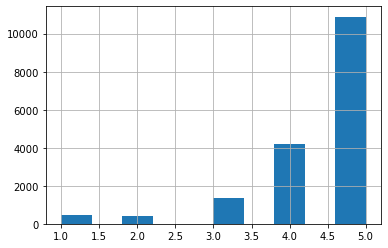

In [28]:
df['rating'].hist()

In [32]:
#df 복사본 만들기
import copy
df_model = copy.deepcopy(df)
df_model

,hotelName,rating,review
0,포포인츠 바이 쉐라톤 서울역,2,베트남에서묵어보고좋아서한국에서또예약했는데방에들어가자마자실망이었네요 이불위에머리카락있...
1,포포인츠 바이 쉐라톤 서울역,5,호텔 시설과 객실의 관리 상태는 매우 좋습니다. 침대도 사치품은 아니지만 편하게 자...
2,포포인츠 바이 쉐라톤 서울역,1,비지니스 일정으로 평일에 투숙하였습니다. 호텔의 시설이나 직원의 서비스를 평가하기...
3,포포인츠 바이 쉐라톤 서울역,1,이 호텔은 수준은 그냥 동네 모텔 수준 입이다 1.방에 먼저 엄청 많아요 2.노후...
4,포포인츠 바이 쉐라톤 서울역,3,총점 70점 로비 첫인상은 클래식한 느낌 나쁘진않음 엘레베이터는 빠르고 잘되어있음...
...,...,...,...
17337,라온 게스트하우스,5,남편과 나는 이 곳에서 1박 하는 것입니다. 주인은 아주 친절하고 도움이 되었습니다...
17338,라온 게스트하우스,5,우리는 밤 늦게 체크인을 해 주는 친절한 주인이 특별 할인. 경험하고 싶다면 완벽한...
17339,라온 게스트하우스,5,"놀라운 위치한 라온 게스트하우스 - 서울의 한 가운데에, 경복궁 바로 옆. 주인들은..."
17340,라온 게스트하우스,4,"수백 년 된 오래된 전통 가옥 이 궁전에 ""경복궁"". 주인도 매우 친절하고 제공된 ..."


In [33]:
# 평점 4,5점은 1로, 1~3점은 0으로
def rating_to_label(rating):
    if rating > 3:
        return 1
    else:
        return 0
    
df_model['y'] = df_model['rating'].apply(lambda x: rating_to_label(x))

In [34]:
df_model

,hotelName,rating,review,y
0,포포인츠 바이 쉐라톤 서울역,2,베트남에서묵어보고좋아서한국에서또예약했는데방에들어가자마자실망이었네요 이불위에머리카락있...,0
1,포포인츠 바이 쉐라톤 서울역,5,호텔 시설과 객실의 관리 상태는 매우 좋습니다. 침대도 사치품은 아니지만 편하게 자...,1
2,포포인츠 바이 쉐라톤 서울역,1,비지니스 일정으로 평일에 투숙하였습니다. 호텔의 시설이나 직원의 서비스를 평가하기...,0
3,포포인츠 바이 쉐라톤 서울역,1,이 호텔은 수준은 그냥 동네 모텔 수준 입이다 1.방에 먼저 엄청 많아요 2.노후...,0
4,포포인츠 바이 쉐라톤 서울역,3,총점 70점 로비 첫인상은 클래식한 느낌 나쁘진않음 엘레베이터는 빠르고 잘되어있음...,0
...,...,...,...,...
17337,라온 게스트하우스,5,남편과 나는 이 곳에서 1박 하는 것입니다. 주인은 아주 친절하고 도움이 되었습니다...,1
17338,라온 게스트하우스,5,우리는 밤 늦게 체크인을 해 주는 친절한 주인이 특별 할인. 경험하고 싶다면 완벽한...,1
17339,라온 게스트하우스,5,"놀라운 위치한 라온 게스트하우스 - 서울의 한 가운데에, 경복궁 바로 옆. 주인들은...",1
17340,라온 게스트하우스,4,"수백 년 된 오래된 전통 가옥 이 궁전에 ""경복궁"". 주인도 매우 친절하고 제공된 ...",1


In [35]:
df_model["y"].value_counts()

1    15094
0     2248
Name: y, dtype: int64

In [36]:
from sklearn.model_selection import train_test_split

x = tf_idf_vect
y = df_model['y']
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.3, random_state=1)

In [37]:
x_train.shape ,y_train.shape

((12139, 13837), (12139,))

In [38]:
x_test.shape, y_test.shape

((5203, 13837), (5203,))

### 1. Logistic Regression

## 2-7-1.모델 학습

In [35]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# fit in training set
lr = LogisticRegression(random_state = 0)
lr.fit(x_train, y_train)

# predict in test set
y_pred = lr.predict(x_test)

In [36]:
# 분류 결과 평가
# classification result for test set

print('accuracy: %.2f' % accuracy_score(y_test, y_pred))
print('precision: %.2f' % precision_score(y_test, y_pred))
print('recall: %.2f' % recall_score(y_test, y_pred))
print('F1: %.2f' % f1_score(y_test, y_pred))

accuracy: 0.90
precision: 0.90
recall: 1.00
F1: 0.95


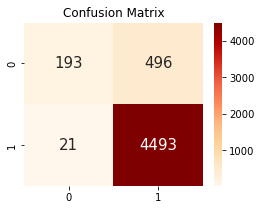

In [37]:
# confusion matrix
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import confusion_matrix

confu = confusion_matrix(y_true = y_test, y_pred = y_pred)

plt.figure(figsize=(4, 3))
sns.heatmap(confu, annot=True, annot_kws={'size':15}, cmap='OrRd', fmt='.10g')
plt.title('Confusion Matrix')
plt.show()

## 2-7-2. 샘플링 재조정

##### 모델 평가결과를 살펴보면, 모델이 지나치게 긍정(“1”)으로만 예측하는 경향이 있다. 
##### 따라서 긍정 리뷰를 잘 예측하지만, 부정 리뷰에 대한 예측 정확도가 매우 낮다. 
##### 이는 샘플데이터의 클래스 불균형으로 인한 문제로 보임.
##### 따라서, 클래스 불균형 조정을 진행

In [39]:
df_model['y'].value_counts()

1    15094
0     2248
Name: y, dtype: int64

In [40]:
# 긍정, 부정 리뷰 각각 2248개를 랜덤하게 뽑아 다시 실행
positive_random_idx = df_model[df_model['y']==1].sample(2248, random_state=12).index.tolist()
negative_random_idx = df_model[df_model['y']==0].sample(2248, random_state=12).index.tolist()
random_idx = positive_random_idx + negative_random_idx
x = tf_idf_vect[random_idx]
y = df_model['y'][random_idx]
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.25, random_state=1)

In [41]:
x_train.shape, y_train.shape

((3372, 13837), (3372,))

In [42]:
x_test.shape, y_test.shape

((1124, 13837), (1124,))

## 2-7-3. 모델 재학습

In [40]:
lr2 = LogisticRegression(random_state = 0)
lr2.fit(x_train, y_train)
y_pred = lr2.predict(x_test)

NameError: name 'LogisticRegression' is not defined

In [44]:
# classification result for test set

print('accuracy: %.2f' % accuracy_score(y_test, y_pred))
print('precision: %.2f' % precision_score(y_test, y_pred))
print('recall: %.2f' % recall_score(y_test, y_pred))
print('F1: %.2f' % f1_score(y_test, y_pred))

accuracy: 0.81
precision: 0.81
recall: 0.79
F1: 0.80


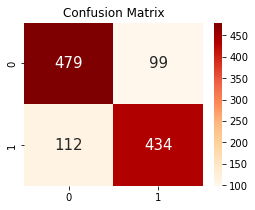

In [45]:
# confusion matrix

from sklearn.metrics import confusion_matrix

confu = confusion_matrix(y_true = y_test, y_pred = y_pred)

plt.figure(figsize=(4, 3))
sns.heatmap(confu, annot=True, annot_kws={'size':15}, cmap='OrRd', fmt='.10g')
plt.title('Confusion Matrix')
plt.show()

## 2-7-4. 긍정/부정 키워드 분석

In [43]:
# 각 단어의 coefficient 출력
lr2.coef_

AttributeError: coef_ is only available when using a linear kernel

##### 계수가 양인 경우는 단어가 긍정적인 영향을 미쳤다고 볼 수 있고, 반면에, 음인 경우는 부정적인 영향을 미쳤다고 볼 수 있다.
##### 이 계수들을 크기순으로 정렬하면, 긍정 / 부정 키워드를 출력하는 지표가 되겠습니다.

In [47]:
coef_pos_index = sorted(((value, index) for index, value in enumerate(lr2.coef_[0])), reverse = True)
coef_neg_index = sorted(((value, index) for index, value in enumerate(lr2.coef_[0])), reverse = False)
coef_pos_index

[(2.9140117180053475, 4554),
 (2.799624725936478, 11184),
 (2.63110665000026, 5928),
 (2.204981231853817, 13522),
 (2.1102762352024746, 11247),
 (2.0716350656921163, 3868),
 (2.0380408116473046, 3466),
 (1.9539739663611944, 4548),
 (1.952221447349759, 10686),
 (1.9094993029923777, 11389),
 (1.8715914285657367, 2395),
 (1.680394173149397, 8984),
 (1.5997793506946447, 7300),
 (1.5650117306206246, 7557),
 (1.4750360516862098, 13447),
 (1.4744501530507517, 2069),
 (1.4611230589035058, 10444),
 (1.448788106990258, 5201),
 (1.44589545990766, 10614),
 (1.4401327839876619, 58),
 (1.428266854599301, 105),
 (1.426525314217892, 11408),
 (1.3650722081131235, 10047),
 (1.3422917409039241, 9593),
 (1.330098124740866, 11907),
 (1.3176830888402205, 4001),
 (1.2835868807905815, 201),
 (1.2391670276683602, 1397),
 (1.2364695484868033, 10285),
 (1.2334860979116502, 9466),
 (1.2260232071673172, 9940),
 (1.2071742863927593, 9816),
 (1.140150208372113, 4677),
 (1.0979010689025288, 197),
 (1.069092717102993,

In [48]:
invert_index_vectorizer = {v: k for k, v in vect.vocabulary_.items()}
invert_index_vectorizer

{4815: '베트남',
 4891: '보고',
 8202: '예약',
 7060: '실망',
 5253: '불위',
 3690: '머리카락',
 5932: '서울역',
 8781: '위치',
 7999: '여행객',
 49: '가방',
 5194: '분실물',
 2517: '도제',
 2168: '달라',
 11070: '청소',
 6865: '시설',
 878: '관리',
 5782: '상태',
 3644: '매우',
 11410: '침대',
 5622: '사치품',
 5116: '부족함',
 2380: '더블',
 11775: '크기',
 7300: '아주',
 1078: '국철',
 833: '공항철도',
 13423: '호선',
 10658: '지하',
 12105: '통로',
 151: '간선',
 4702: '버스정류장',
 5455: '빌딩',
 12499: '편의점',
 10142: '제과점',
 155: '간식',
 380: '거리',
 424: '건물',
 2701: '뒤쪽',
 13715: '후암동',
 13125: '합리',
 4: '가격',
 6940: '식사',
 2589: '동네',
 6927: '식당',
 7948: '여럿',
 2355: '대해',
 1743: '내용',
 1021: '구성',
 5554: '사무',
 10979: '책상',
 9298: '인용',
 12036: '테이블',
 6458: '수트',
 11620: '케이스',
 2357: '대형',
 771: '공간',
 5484: '빠듯합니',
 6272: '소형',
 112: '가지',
 8376: '옷장',
 12500: '편이',
 13572: '화장실',
 7122: '싱크',
 3818: '명분',
 13575: '화장품',
 9391: '일부',
 4845: '변기',
 4142: '물탱크',
 5611: '사정',
 5583: '사용',
 12218: '트윈',
 2387: '더욱',
 13430: '호실',
 1687: '남산',
 13020: '한

In [87]:
# 긍정 키워드 Top20
for coef in coef_pos_index[:100]:
    print(invert_index_vectorizer[coef[1]], coef[0])

방문 2.9140117180053475
최고 2.799624725936478
서울 2.63110665000026
홍대 2.204981231853817
추천 2.1102762352024746
모든 2.0716350656921163
마음 2.0380408116473046
방도 1.9539739663611944
직원 1.952221447349759
친구 1.9094993029923777
덕분 1.8715914285657367
응대 1.680394173149397
아주 1.5997793506946447
야경 1.5650117306206246
호캉스 1.4750360516862098
다시 1.4744501530507517
주인 1.4611230589035058
분위기 1.448788106990258
지배인 1.44589545990766
가성 1.4401327839876619
가족 1.428266854599301
침구 1.426525314217892
정말 1.3650722081131235
자주 1.3422917409039241
타임스퀘어 1.330098124740866
무료 1.3176830888402205
감사 1.2835868807905815
기회 1.2391670276683602
조식 1.2364695484868033
임형철 1.2334860979116502
전통 1.2260232071673172
적극 1.2071742863927593
백화점 1.140150208372113
감동 1.0979010689025288
컨디션 1.069092717102993
매우 1.0663116440657572
항상 1.0622203651164166
호스트 1.0434603656287358
업그레이드 1.0323255932639217
도심 1.0189738799294412
점도 1.0182310525031926
맛집 1.0066561597885115
음식 0.9967705532834322
역시 0.9782580267616148
공원 0.9777644125696487
일찍 0.972360

In [83]:
# 부정 키워드 Top20
for coef in coef_neg_index[:40]:
    print(invert_index_vectorizer[coef[1]], coef[0])

별로 -3.221402776118007
최악 -2.957252565898726
냄새 -2.5978077297415907
그냥 -2.4586342439882034
실망 -2.3721106630101176
소리 -2.168088851902629
모텔 -2.121537329525671
이해 -1.9879865625700888
먼지 -1.9853359249295448
작고 -1.8754355524512498
청소 -1.7748695768003102
변경 -1.7540777674116677
고객 -1.6431052541831597
고장 -1.5765546170153757
개선 -1.5750502860049571
달라 -1.564488012885534
나름 -1.5413140252371302
창문 -1.5321040693135137
물이 -1.5271338264346312
머리카락 -1.5115941941296573
전혀 -1.4947939821243543
태도 -1.471727853471203
좀더 -1.4215885812148987
가방 -1.4140706570695838
수준 -1.3970540381561012
나은 -1.3864492155435735
비아그라 -1.3794651806638312
장점 -1.3563029908387663
힐튼 -1.3430083380511266
수건 -1.3409778915757522
에어컨 -1.309647200384549
소음 -1.3091782833562928
대한 -1.2781865841322504
기본 -1.2705643312361874
낙태 -1.2424229651740115
서서 -1.2365981032382602
라면 -1.2228009084973694
만원 -1.2149724528053567
예약 -1.210272124426328
중이 -1.2027393748096629


## 3. 모델 적합

## SVM 모델 적합 (최종선택)

In [43]:
from sklearn.svm import SVC

# 사용할 모델 객체 생성
svc = SVC(C=1, gamma=1)
svc.fit(x_train, y_train)

y_pred = svc.predict(x_test)

In [44]:
# classification result for test set
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

print('accuracy: %.2f' % accuracy_score(y_test, y_pred))
print('precision: %.2f' % precision_score(y_test, y_pred))
print('recall: %.2f' % recall_score(y_test, y_pred))
print('F1: %.2f' % f1_score(y_test, y_pred))

accuracy: 0.83
precision: 0.82
recall: 0.84
F1: 0.83


## 2. KNN

In [50]:
from sklearn.neighbors import KNeighborsClassifier
# 사용할 모델 객체 생성
knn = KNeighborsClassifier()
knn.fit(x_train, y_train)

y_pred = knn.predict(x_test)

In [51]:
print('accuracy: %.2f' % accuracy_score(y_test, y_pred))
print('precision: %.2f' % precision_score(y_test, y_pred))
print('recall: %.2f' % recall_score(y_test, y_pred))
print('F1: %.2f' % f1_score(y_test, y_pred))

accuracy: 0.69
precision: 0.63
recall: 0.87
F1: 0.73


## 3. SVM

In [178]:
from sklearn.svm import SVC

# 사용할 모델 객체 생성
svc = SVC()
svc.fit(x_train, y_train)

y_pred = svc.predict(x_test)

In [179]:
print('accuracy: %.2f' % accuracy_score(y_test, y_pred))
print('precision: %.2f' % precision_score(y_test, y_pred))
print('recall: %.2f' % recall_score(y_test, y_pred))
print('F1: %.2f' % f1_score(y_test, y_pred))

accuracy: 0.82
precision: 0.80
recall: 0.84
F1: 0.82


## 4. RandomForest

In [180]:
from sklearn.ensemble import RandomForestClassifier

# 사용할 모델 객체 생성
rf = RandomForestClassifier(random_state=1)
rf.fit(x_train, y_train)

y_pred = rf.predict(x_test)

In [181]:
print('accuracy: %.2f' % accuracy_score(y_test, y_pred))
print('precision: %.2f' % precision_score(y_test, y_pred))
print('recall: %.2f' % recall_score(y_test, y_pred))
print('F1: %.2f' % f1_score(y_test, y_pred))

accuracy: 0.79
precision: 0.76
recall: 0.84
F1: 0.80


## 5. XGBoost

In [183]:
pip install xgboost

Note: you may need to restart the kernel to use updated packages.


In [184]:
from xgboost import XGBClassifier

xgb = XGBClassifier(silent=True, verbosity=0)
xgb.fit(x_train, y_train)

y_pred = xgb.predict(x_test)

In [185]:
print('accuracy: %.2f' % accuracy_score(y_test, y_pred))
print('precision: %.2f' % precision_score(y_test, y_pred))
print('recall: %.2f' % recall_score(y_test, y_pred))
print('F1: %.2f' % f1_score(y_test, y_pred))

accuracy: 0.79
precision: 0.78
recall: 0.81
F1: 0.79


### ** GridSearchCV를 이용해 하이퍼파라미터 찾기

In [191]:
# KNN
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import KFold

params = {
 "n_neighbors" : list(range(1, 11))
}

# 사용할 모델 객체 생성
model1 = KNeighborsClassifier()

# 최적의 하이퍼 파라미터를 찾는다. 
kfold = KFold(n_splits=10, shuffle=True, random_state = 1)
grid_clf1 = GridSearchCV(model1, param_grid = params, scoring="f1", cv=kfold)
grid_clf1.fit(x_train, y_train)

# 결과 출력
print(f"최적의 하이퍼 파라미터 : {grid_clf1.best_params_}")
print(f"최적의 모델 평균 성능 : {grid_clf1.best_score_}")

최적의 하이퍼 파라미터 : {'n_neighbors': 10}
최적의 모델 평균 성능 : 0.7449117966683076


In [41]:
# SVM(SVC)
# SVM은 penalty가 l2로 고정되어 있다
# C : 규제의 강도
# gamma : 가까이 있는 것에 얼마나 더 가중치를 줄 것인가

from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import KFold
from sklearn.svm import SVC

kfold = KFold(n_splits=10, shuffle=True, random_state = 1)

params = {
    'C' : [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000, 10000],
    'gamma' : [0.01, 0.03, 0.1, 0.3, 1, 3]
}

model3 = SVC()

grid_clf3 = GridSearchCV(model3, param_grid=params, scoring='f1', cv=kfold)
grid_clf3.fit(x_train, y_train)

print(f'최적의 하이퍼 파라미터 : {grid_clf3.best_params_}')
print(f'최적의 모델 평균 성능 : {grid_clf3.best_score_}')

최적의 하이퍼 파라미터 : {'C': 1, 'gamma': 1}
최적의 모델 평균 성능 : 0.8360866502998092


In [196]:
# RandomForest
# n_estimators : 사용할 트리의 개수
# max_depth : 생성될 최대 질문 깊이, None은 무한대.
params = {
    'n_estimators' : [50, 100, 150, 200, 250, 300],
    'max_depth' : [None, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
}

model4 = RandomForestClassifier(random_state=1)

grid_clf4 = GridSearchCV(model4, param_grid=params, scoring='f1', cv=kfold)
grid_clf4.fit(x_train, y_train)

print(f'최적의 하이퍼 파라미터 : {grid_clf4.best_params_}')
print(f'최적의 모델 평균 성능 : {grid_clf4.best_score_}')

최적의 하이퍼 파라미터 : {'max_depth': None, 'n_estimators': 200}
최적의 모델 평균 성능 : 0.8191073177425213


In [197]:
# XGBoost
# booster : 내부에 사용할 알고리즘
# learning_rate : 학습률
# n_estimators : 사용할 트리의 개수
# max_depth : 생성될 최대 질문 깊이, None은 무한대.

params = {
    'booster' : ['gbtree', 'gblinear'],
    'learning_rate' : [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000, 10000],
    'n_estimators' : [50, 100, 150, 200, 250, 300],
    # 'max_depth' : [None, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
}

model5 = XGBClassifier(silent=True, verbosity=0)

grid_clf5 = GridSearchCV(model5, param_grid=params, scoring='f1', cv=kfold)
grid_clf5.fit(x_train, y_train)

print(f'최적의 하이퍼 파라미터 : {grid_clf5.best_params_}')
print(f'최적의 모델 평균 성능 : {grid_clf5.best_score_}')

최적의 하이퍼 파라미터 : {'booster': 'gbtree', 'learning_rate': 0.1, 'n_estimators': 300}
최적의 모델 평균 성능 : 0.807243022864062


## 4. 모델 적합 이후 단계

### 예측 결과 살펴보기

In [43]:
svc = SVC()
svc.fit(x_train, y_train)
y_pred = svc.predict(x_test)

In [45]:
y_test

9801     0
9056     1
12285    1
261      1
16660    1
        ..
10078    0
9951     0
13168    0
3795     0
7888     0
Name: y, Length: 1124, dtype: int64

## 긍정인 리뷰 데이터

In [46]:
y_test_p = y_test[y_test==1]

In [47]:
# test 데이터 중 긍정으로 예측한 리뷰들만 모으기
df_positive = df.loc[y_test_p.index]
df_positive

,hotelName,rating,review
9056,뉴국제호텔,4,저희는 2박. 그들은 짐을 검사하기 전에 - 소요 시간 및 필요한 모든 정보는 많은...
12285,L7 홍대,5,커플로 가기에 너무 좋습니다. 호텔 내부가 매우 예쁘고 잘 꾸며져 있습니다. 조식 ...
261,롯데 시티 호텔 명동,5,"체크아웃시간이 넉넉해 다음 날 걱정없이 놀기에 딱이에요!! 내부도 깔끔하고, 주변에..."
16660,집게스트하우스,5,"같은 내 이름을 말한다. 저는 항상 이 호스텔이 서울에 올 때마다 정확한; 위치, ..."
4259,로얄 호텔 서울,5,조식도 만족스럽고 방도 넓은 편입니다~ 직원분들도 너무 친절하시고 만족스럽네요. 다...
...,...,...,...
16167,바운스 게스트하우스,5,게스트 하우스 주인이 될 수 있도록 최선을 다하고 있는 것은 집에서 느낄 수 있었다...
7785,AC 호텔 바이 메리어트 서울 강남,5,강남쪽에서 이렇게 좋은 가격에 이렇게 편리한 위치의 호텔.머큐어 서울 앰베서더 강남...
14103,코트야드 메리어트 서울 타임스퀘어,5,메리어트는 세계적으로 유명한 호텔체인점답게 청결한 숙박시설을 제공하며 무엇보다 가격...
1379,호텔 스카이파크 명동 2,5,명동에서 가장 맛있는 음식이있는 바로 옆에 자리 잡고있어 길을 걸어 다니면 선택의 ...


In [48]:
df_positive['rating'].unique()

array([4, 5], dtype=int64)

In [49]:
# 호텔 이름으로 정렬
df_positive = df_positive.sort_values(by=["hotelName"], ascending=[True])
df_positive

,hotelName,rating,review
14997,24게스트하우스 신촌,5,최악의 경우 에 도착했을 때 아직 조임나사 싫어 짐을 짐 무게 두 배로 돌아오면. ...
15753,AC 호텔 바이 메리어트 서울 강남,4,역삼역에서 가깝다는 글은 보고 갔지만 너무 가까워서 놀랬다. 스타벅스에서 길만 건너...
7834,AC 호텔 바이 메리어트 서울 강남,5,2호선 역삼역 바로 옆이라 이동이 매우 편리 했고 객실 자체가 너무 예뻤습니다. 객...
7852,AC 호텔 바이 메리어트 서울 강남,5,50프로 할인 행사때 서울 머큐어 엠버서더에서 2박 숙박 했습니다. 호텔 정말 깔끔...
15793,AC 호텔 바이 메리어트 서울 강남,5,"강남 도심에 위치하여 버스, 지하철 이용에도 손색이 없는 아주 편리한 위치에 있습니..."
...,...,...,...
14494,호텔더디자이너스 건대점,4,품질이 등록하는 질환. 그냥 몇 가지의 소유주가 없어지지 자 제안 / 관리자는 각 ...
11283,호텔벤허,5,"나는 이 호텔이 손님이었는데, 한 임대 전용 가라오케 룸. 실망시키지 않았어요! 서..."
10395,홀리데이인 익스프레스 서울홍대,5,방문하고자하는 회사와 가까우며 Holiday Inn 그룹에 속했기 때문에이 호텔을 ...
13186,홍대스타일 게스트하우스,5,친구 5명과 가서 정말 편안하게 쉬다왔습니다 ㅎㅎ 숙소 정말 조용하고 좋았구요 아침...


In [50]:
#호텔 리스트
hotelList = df_positive['hotelName'].unique()
hotelList

array(['24게스트하우스 신촌', 'AC 호텔 바이 메리어트 서울 강남', 'DW 디자인 레지던스', 'ENA스위트호텔',
       'G 이태원 게스트하우스', 'G2 호텔', 'IBC 호텔', 'JW 메리어트 동대문 스퀘어 서울',
       'JW 메리어트 호텔 서울', 'L7 홍대', 'SR Hotel', '게스트하우스 서울삼촌',
       '강남 아르누보 씨티 II', '강남 패밀리 호텔', '게스트하우스 더 힐', '골드리버호텔', '그라모스 호텔',
       '그랜드 머큐어 앰배서더 호텔 앤 레지던스 서울 용산', '그랜드 인터컨티넨탈 서울 파르나스',
       '글래드 강남 코엑스 센터', '글래드 호텔 여의도', '글로리 인', '글루 호텔', '나인트리 호텔 동대문',
       '나인트리 호텔 명동', '남산 힐 호텔', '노보텔 스위트 앰배서더 서울 용산', '노보텔 앰배서더 서울 강남 호텔',
       '노보텔 앰배서더 서울 동대문 호텔', '노보텔 앰배서더 서울 용산', '노블레스 역삼 호텔 서울', '녹스 호텔',
       '뉴국제호텔', '뉴서울 호텔', '대영호텔 서울', '더 플라자', '더리센츠동대문호텔', '도미인 서울 강남',
       '라마다 서울 동대문', '라온 게스트하우스', '락 고재 서울 (북촌 한옥 마을)', '레스케이프 호텔',
       '레이지폭스', '레지던스 유니콘 인 동대문', '로얄 호텔 서울', '로얄스퀘어 호텔', '롯데 시티 호텔 구로',
       '롯데 시티 호텔 김포공항', '롯데 시티 호텔 마포', '롯데 시티 호텔 명동', '롯데호텔 서울',
       '롯데호텔 서울 이그제큐티브 타워', '류게스트하우스', '리앤노 게스트하우스', '머스트 스테이 호텔 명동점',
       '메이 플레이스 서울 동대문', '메이필드 호텔 앤 리조트', '메트로 호텔', '명동 지스타 게스트하우스',
       '명동케이스테이 2호점',

In [122]:
df_review = pd.DataFrame([['sample', 'sample']], columns=['hotelName', 'review'])
df_review

,hotelName,review
0,sample,sample


In [123]:
#중복 있는 리스트
for i in hotelList:
    review = df_positive[df_positive['hotelName']==i]['review'].tolist()
    review2 = "".join(review)
    new_data = {'hotelName':i, 'review':review2}
    print(new_data)
    df_review = df_review.append(new_data, ignore_index=True)

{'hotelName': '24게스트하우스 신촌', 'review': '최악의 경우 에 도착했을 때 아직 조임나사 싫어 짐을 짐 무게 두 배로 돌아오면.  신촌에 위치한 이 게스트 하우스에서 8 번 출구. 짐을 들고 가면 엘리베이터가 4번 출구. 길을 건너 왼쪽으로 계속 걸어가면 몇 가지 단계가 도로 교통 신호 교차로 를 참조하십시오. 길 건너편에 보두 아리따움 음식 가판대. 그 사이 길 직진하는 24 게스트 하우스 바로 앞에서 오른쪽으로 돌아 볼 수 있습니다.  방은 충분히 넓은 하나. 매우 깨끗하고 편안한 테이블. 이 입방체 선반 옷장, 책상, 냉장고, 전자레인지, 식기 세척기 와 스토브. 기본적으로 모든 소형 아파트 하나. 방에 있는 화장실은 조금 흔들리는 두려워 할 보우 붕괴,  직원들은 매우 친절하고 도움이 되고, 주인인 것 같아 저는 해결 tv 는 있었지만 그는 다음 날 아침에 고쳐 연결만. 그들은 고기 요리 를 요청할 수 있는데, 하지만 칼과 가려면 다이소 culteries 사용할 수 없는 경우 또는 근처의 편의점,  맞은 편에는 수많은 레스토랑이 밤 늦게 까지 여는 게스트 하우스. 이화 도 홍대 걸어서 할 수도 있고.  최고의 게스트하우스 신촌.'}
{'hotelName': 'AC 호텔 바이 메리어트 서울 강남', 'review': '역삼역에서 가깝다는 글은 보고 갔지만 너무 가까워서 놀랬다. 스타벅스에서 길만 건너면 바로 보인다. 객실은 생각보다 너무 작아서 놀랬고 욕실과 화장실 구조가 특이해서 놀랬다. 욕실을 이용할때 미닫이 문을 닫으라고 하는데 귀찮기도 하고 닫으면 방이 더 작아 보여서 답답하기도 했다. 의자가 하나밖에 없어서 하나 더 요텅 했는데 직원분께서 친절하게 가져다 주셔셔 감사했다. 그리고 어메니티는 향이 너무 좋고 샴푸가 부드러워서 좋았다. 또한가지 좋았던 것은 바닥이 나무여서 깨끗했다. 가족 여행 보다는 출장이나 강남에서 일 있을때 하루 쉬기 딱 좋은 호텔이다.2호선 역삼역 바로 옆이라 이동이 매우 편리 했고 객실 자체가 너무 

{'hotelName': '호텔더디자이너스 건대점', 'review': '품질이 등록하는 질환. 그냥 몇 가지의 소유주가 없어지지 자 제안 / 관리자는 각 방에서 하룻밤을. 예를 들어, 불편하게 하지 않은 위치에 꽂아서 파워 포인트 옆에 충분히 사용 가능 장치 (또는 전기 주전자 데스크, 일부 방에는 샤워 물 분사 문제를 해결할 수 있습니다.  나는 10일 동안 두 개의 방 - 첫 번째 방에 두 번째 수준 평균 또는 기대가 없었고, 직원들은 친절하게 이전이나 이후 나는 십분 의 나머지 층에 불평 했습니다. 2층에 있는 방이 차는 작은 샤워 할 때 물이 욕실에 있는 침수 shoebox, 짐을 둘 수 있는 아무데도 없다. 방은 매우 뜨거운 밤 - 온돌 난방 의 전원 스위치 및 왼쪽에는 느낌 구운 할 수 없다. 방은 매우 작았고 정말 끔찍한 느낌이 잘 되는 수면. 유일한 탈출 을 열어 작은 배가 - 유리창 (하지만 거리의 소음은 절대적으로 불가능한 도로 교통 함께 잠을 잘 수 있는). 직원들이 제공하는 경우 더 큰 방으로 다음 날 아침 날 것도 미리 예약을 하기 때문에 호텔을 떠나 제 2 차 바닥 상실되어 잠글 수 있는 객실은 참을 수 없이 뜨거운 숨 막힐듯한 셀.  10층 방에서, 하지만, 이 훨씬 더 나은, 더 넓고, 짐을 보관할 수 있는 공간, windows 및 열 수 있는 최대 수 있는 대부분의 트래픽을 방지하기 위해 거리에서 들리는 소리지. 이 방에는 좌석이 몇 개, 넓은 욕실은 샤워/욕실, 그리고 바람이 잘 통하는 느낌 (과는 달리 작은 방에서 밀실 공포증을 느끼게 되는). 모든 것이 높은 품질의 - 린넨, 가전 제품, 가구, 등이 있습니다. 전체적으로 호텔은 매우 높은 수준의 마무리는 구축과 우수한 품질.  무선 인터넷이 무료이고 안정적인, 그리고 호텔은 우수한 품질 및 평면 tv 가 모든 방에 큰 가구가 아주 좋습니다. 아래층에 있는 빵집 / 카페는 아주 좋은, 합리적인 어떤 좋은 커피, 맛있는 것들은 모든 일에 메뉴에 구운 항목과 직접 만든 특별한 

In [124]:
#긍정으로 예측한 호텔들(같은 호텔들 리뷰는 묶어서)
df_review

,hotelName,review
0,sample,sample
1,24게스트하우스 신촌,최악의 경우 에 도착했을 때 아직 조임나사 싫어 짐을 짐 무게 두 배로 돌아오면. ...
2,AC 호텔 바이 메리어트 서울 강남,역삼역에서 가깝다는 글은 보고 갔지만 너무 가까워서 놀랬다. 스타벅스에서 길만 건너...
3,DW 디자인 레지던스,전략적 위치: 홍대 입구역 1번 출구 근처에 식료품 가게 바로 옆에 & 2.. 객...
4,ENA스위트호텔,일때문에 멀리 여행못가는 상황에 주말 하루동안 기분전환할겸 호텔을 알아보다가 투숙하...
...,...,...
165,호텔더디자이너스 건대점,품질이 등록하는 질환. 그냥 몇 가지의 소유주가 없어지지 자 제안 / 관리자는 각 ...
166,호텔벤허,"나는 이 호텔이 손님이었는데, 한 임대 전용 가라오케 룸. 실망시키지 않았어요! 서..."
167,홀리데이인 익스프레스 서울홍대,방문하고자하는 회사와 가까우며 Holiday Inn 그룹에 속했기 때문에이 호텔을 ...
168,홍대스타일 게스트하우스,친구 5명과 가서 정말 편안하게 쉬다왔습니다 ㅎㅎ 숙소 정말 조용하고 좋았구요 아침...


In [125]:
# 같은 호텔들끼리는 리뷰 합침
sum(df_review.duplicated(['hotelName']))

0

## 5.호텔별 7개 키워드의 TF-IDF 지표 확인

In [52]:
#데이터 정규화 
from sklearn.feature_extraction.text import CountVectorizer

def text_cleaning(text):
    hangul = re.compile('[^ ㄱ-ㅣ 가-힣]')  # 정규 표현식 처리
    result = hangul.sub('', text)
    okt = Okt()  # 형태소 추출
    nouns = okt.nouns(result)
    nouns = [x for x in nouns if len(x) > 1]  # 한글자 키워드 제거
    nouns = [x for x in nouns if x not in new_stopwords]  # 불용어 제거
    return nouns

vect = CountVectorizer(tokenizer = lambda x: text_cleaning(x))
bow_vect = vect.fit_transform(df_review['review'].tolist())
word_list = vect.get_feature_names()
count_list = bow_vect.toarray().sum(axis=0)

In [53]:
#명사 단어 리스트
word_list

['가가',
 '가게',
 '가격',
 '가공',
 '가구',
 '가기',
 '가까이',
 '가끔',
 '가나',
 '가능',
 '가도',
 '가득',
 '가든',
 '가라오케',
 '가로',
 '가로등',
 '가면',
 '가방',
 '가사',
 '가성',
 '가스',
 '가스렌지',
 '가습기',
 '가야',
 '가열',
 '가옥',
 '가요',
 '가우리',
 '가운',
 '가운데',
 '가을',
 '가이드',
 '가이드라인',
 '가인',
 '가입',
 '가장',
 '가전',
 '가정',
 '가정은',
 '가족',
 '가지',
 '가짓수',
 '가치',
 '가파른',
 '가판',
 '각국',
 '각설이',
 '간김',
 '간다',
 '간만',
 '간선',
 '간소',
 '간식',
 '간에이',
 '간이',
 '간지',
 '갈비',
 '갈수',
 '감각',
 '감동',
 '감사',
 '감성',
 '감안',
 '갑자기',
 '강남',
 '강남구',
 '강남역',
 '강력',
 '강아지',
 '강점',
 '강추',
 '갖가지',
 '개량',
 '개발',
 '개별',
 '개선',
 '개성',
 '개심',
 '개업',
 '개월',
 '개인',
 '개장',
 '개정',
 '개조',
 '개통',
 '갱도',
 '걔르',
 '거기',
 '거래',
 '거려',
 '거리',
 '거실',
 '거울',
 '거주',
 '거품',
 '걱정',
 '건강',
 '건너',
 '건너편',
 '건물',
 '건아',
 '건조',
 '건조기',
 '건축',
 '걸레',
 '걸음',
 '걸이',
 '검사',
 '검색',
 '검토',
 '것임',
 '것저',
 '게스트하우스',
 '게이트',
 '게임기',
 '겔이',
 '겨울',
 '격의',
 '격조',
 '견과류',
 '견해',
 '결과',
 '결점',
 '결정',
 '결제',
 '결코',
 '결함',
 '결합',
 '결혼',
 '결혼기념일',
 '결혼식',
 '경고',
 '경관',
 '경기도',
 '경기장',
 '경로',
 '경리',
 '경

In [54]:
# 각 단어가 전체 리뷰중에 등장한 총 횟수
count_list

array([  2,  13, 110, ...,   1,   3,   5], dtype=int64)

In [55]:
# 각 단어의 리뷰별 등장 횟수
# 각 행은 리뷰, 각 열은 단어
bow_vect.toarray()

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 3, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=int64)

In [56]:
bow_vect.shape

(170, 2746)

In [57]:
# "단어" - "총 등장 횟수" Matching
word_count_dict = dict(zip(word_list, count_list))
word_count_dict

{'가가': 2,
 '가게': 13,
 '가격': 110,
 '가공': 1,
 '가구': 9,
 '가기': 9,
 '가까이': 7,
 '가끔': 3,
 '가나': 1,
 '가능': 7,
 '가도': 1,
 '가득': 5,
 '가든': 3,
 '가라오케': 1,
 '가로': 1,
 '가로등': 1,
 '가면': 7,
 '가방': 8,
 '가사': 1,
 '가성': 17,
 '가스': 1,
 '가스렌지': 1,
 '가습기': 5,
 '가야': 2,
 '가열': 1,
 '가옥': 1,
 '가요': 4,
 '가우리': 1,
 '가운': 3,
 '가운데': 3,
 '가을': 2,
 '가이드': 2,
 '가이드라인': 1,
 '가인': 1,
 '가입': 1,
 '가장': 42,
 '가전': 1,
 '가정': 2,
 '가정은': 1,
 '가족': 51,
 '가지': 40,
 '가짓수': 3,
 '가치': 11,
 '가파른': 4,
 '가판': 1,
 '각국': 1,
 '각설이': 1,
 '간김': 1,
 '간다': 3,
 '간만': 2,
 '간선': 1,
 '간소': 1,
 '간식': 6,
 '간에이': 1,
 '간이': 2,
 '간지': 1,
 '갈비': 1,
 '갈수': 2,
 '감각': 2,
 '감동': 8,
 '감사': 27,
 '감성': 1,
 '감안': 1,
 '갑자기': 1,
 '강남': 34,
 '강남구': 1,
 '강남역': 12,
 '강력': 9,
 '강아지': 3,
 '강점': 1,
 '강추': 3,
 '갖가지': 1,
 '개량': 1,
 '개발': 1,
 '개별': 5,
 '개선': 4,
 '개성': 1,
 '개심': 1,
 '개업': 2,
 '개월': 5,
 '개인': 11,
 '개장': 1,
 '개정': 1,
 '개조': 3,
 '개통': 1,
 '갱도': 1,
 '걔르': 1,
 '거기': 6,
 '거래': 3,
 '거려': 1,
 '거리': 84,
 '거실': 6,
 '거울': 7,
 '거주': 2,
 '거품': 2,
 '걱정': 13,
 '건

In [58]:
from sklearn.feature_extraction.text import TfidfTransformer

tfidf_vectorizer = TfidfTransformer()
tf_idf_vect = tfidf_vectorizer.fit_transform(bow_vect)

In [59]:
print(tf_idf_vect.shape)

(170, 2746)


In [60]:
# 첫 번째 리뷰에서의 단어 중요도(TF-IDF 값) -- 0이 아닌 것만 출력
print(tf_idf_vect[0])

In [61]:
# 첫 번째 리뷰에서 모든 단어의 중요도 -- 0인 값까지 포함
print(tf_idf_vect[0].toarray().shape)
print(tf_idf_vect[0].toarray())

(1, 2746)
[[0. 0. 0. ... 0. 0. 0.]]


In [62]:
#벡터-단어 mapping
vect.vocabulary_

{'최악': 2268,
 '도착': 555,
 '무게': 815,
 '신촌': 1412,
 '위치': 1753,
 '출구': 2282,
 '가면': 16,
 '엘리베이터': 1566,
 '건너': 97,
 '왼쪽': 1695,
 '계속': 149,
 '가지': 40,
 '단계': 469,
 '도로': 543,
 '교통': 234,
 '신호': 1415,
 '교차로': 232,
 '참조': 2205,
 '건너편': 98,
 '아리따움': 1449,
 '음식': 1785,
 '가판': 44,
 '사이': 1116,
 '직진': 2173,
 '오른쪽': 1650,
 '매우': 740,
 '테이블': 2429,
 '입방체': 1911,
 '선반': 1195,
 '옷장': 1680,
 '책상': 2215,
 '냉장고': 403,
 '전자레인지': 1988,
 '식기': 1381,
 '세척': 1224,
 '스토브': 1337,
 '기본': 324,
 '모든': 791,
 '소형': 1258,
 '아파트': 1474,
 '화장실': 2695,
 '보우': 980,
 '붕괴': 1048,
 '직원': 2170,
 '도움': 552,
 '주인': 2112,
 '해결': 2624,
 '아침': 1470,
 '연결': 1598,
 '고기': 160,
 '요리': 1702,
 '요청': 1710,
 '다이소': 460,
 '사용': 1112,
 '근처': 295,
 '편의점': 2511,
 '레스토랑': 633,
 '이화': 1851,
 '홍대': 2683,
 '수도': 1276,
 '최고': 2256,
 '게스트하우스': 112,
 '역삼역': 1594,
 '보고': 968,
 '스타벅스': 1328,
 '생각': 1163,
 '욕실': 1711,
 '구조': 249,
 '이용': 1829,
 '미닫이': 853,
 '기도': 321,
 '의자': 1800,
 '어메니티': 1532,
 '샴푸': 1171,
 '바닥': 876,
 '나무': 370,
 '가족': 39,
 '출장

In [68]:
#특정 단어 지표 확인하는 법/ tf_idf_vect 특정 열 추출하는 법
tf_idf_vect.toarray()[:, [1]]

array([[0.        ],
       [0.        ],
       [0.        ],
       [0.08976427],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.07068369],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.06764856],
       [0.        ],
       [0.        ],
       [0.        ],
       [0.   

In [65]:
keysList = list(vect.vocabulary_.keys())
keysList

['최악',
 '도착',
 '무게',
 '신촌',
 '위치',
 '출구',
 '가면',
 '엘리베이터',
 '건너',
 '왼쪽',
 '계속',
 '가지',
 '단계',
 '도로',
 '교통',
 '신호',
 '교차로',
 '참조',
 '건너편',
 '아리따움',
 '음식',
 '가판',
 '사이',
 '직진',
 '오른쪽',
 '매우',
 '테이블',
 '입방체',
 '선반',
 '옷장',
 '책상',
 '냉장고',
 '전자레인지',
 '식기',
 '세척',
 '스토브',
 '기본',
 '모든',
 '소형',
 '아파트',
 '화장실',
 '보우',
 '붕괴',
 '직원',
 '도움',
 '주인',
 '해결',
 '아침',
 '연결',
 '고기',
 '요리',
 '요청',
 '다이소',
 '사용',
 '근처',
 '편의점',
 '레스토랑',
 '이화',
 '홍대',
 '수도',
 '최고',
 '게스트하우스',
 '역삼역',
 '보고',
 '스타벅스',
 '생각',
 '욕실',
 '구조',
 '이용',
 '미닫이',
 '기도',
 '의자',
 '어메니티',
 '샴푸',
 '바닥',
 '나무',
 '가족',
 '출장',
 '강남',
 '하루',
 '호선',
 '이동',
 '편리',
 '자체',
 '카페트',
 '마루',
 '프로',
 '할인',
 '행사',
 '서울',
 '큐어',
 '엠버',
 '정말',
 '군더더기',
 '큐티브',
 '라운지',
 '휘트니',
 '사우나',
 '비지니스',
 '조식',
 '연어',
 '인상',
 '도심',
 '버스',
 '지하철',
 '손색',
 '아주',
 '후기',
 '인테리어',
 '가구',
 '배치',
 '사무실',
 '건물',
 '커튼',
 '열기',
 '입구',
 '프론트',
 '천정',
 '분위기',
 '내부',
 '통로',
 '조명',
 '두운',
 '커플',
 '손님',
 '동반',
 '로서',
 '마음',
 '느낌',
 '주변',
 '시설',
 '워낙',
 '전혀',
 '방문',
 '일리',
 '커피',
 '

In [66]:
#키워드 index 리스트
word = ['침구', '컨디션', '깨끗', '정돈', 
        '직원', '응대', '지배인', '적극', '호스트', '업그레이드', '도움', '협조', '친절', '세심',
       '야경', '백화점', '도심', '맛집', '공원', '남산', '교통', '지하철',
       '분위기', '조식', '음식', '노트북', '티비', '시설', '세탁기',
       '가성', '무료', '효율']
index_list = []
for i in word:
    index_list.append(keysList.index(i))
index_list

[212,
 221,
 570,
 801,
 43,
 426,
 444,
 1305,
 236,
 794,
 44,
 239,
 1212,
 839,
 170,
 1204,
 102,
 329,
 419,
 176,
 14,
 104,
 118,
 99,
 20,
 633,
 1587,
 130,
 349,
 796,
 645,
 1054]

In [75]:
#170개의 호텔에 대한 32개 키워드의 tf-idf 지표
keyword_vect = tf_idf_vect.toarray()[:, index_list]

In [99]:
final_df= pd.DataFrame([['호텔명', 1, 2, 3, 4, 5]], columns=['호텔명', '청결', '서비스', '위치', '시설','가격'])

In [101]:
#카테고리 별로 합치기

for i in range(0, len(keyword_vect)):
    sanitary =0
    service = 0
    location = 0
    facility = 0
    price = 0
    for j in range(0,4):
        sanitary += keyword_vect[i][j]
    for j in range(4, 14):
        service += keyword_vect[i][j]
    for j in range(14, 22):
        location += keyword_vect[i][j]
    for j in range(22, 29):
        facility += keyword_vect[i][j]
    for j in range(29,32):
        price += keyword_vect[i][j]
    
    new_data = {'호텔명': df_review['hotelName'][i], '청결': sanitary, '서비스': service, '위치': location, '시설': facility, '가격':price}
    final_df = final_df.append(new_data, ignore_index=True)

In [102]:
#최종
#호텔별 카테고리별 tf-idf 지표

final_df

,호텔명,청결,서비스,위치,시설,가격
0,호텔명,1.0,2.000000,3.000000,4.000000,5.0
1,sample,0.0,0.000000,0.000000,0.000000,0.0
2,24게스트하우스 신촌,0.0,0.158975,0.000000,0.076309,0.0
3,AC 호텔 바이 메리어트 서울 강남,0.0,0.000000,0.060577,0.098035,0.0
4,DW 디자인 레지던스,0.0,0.000000,0.000000,0.000000,0.0
...,...,...,...,...,...,...
166,호텔더디자이너스 건대점,0.0,0.000000,0.000000,0.000000,0.0
167,호텔벤허,0.0,0.000000,0.000000,0.000000,0.0
168,홀리데이인 익스프레스 서울홍대,0.0,0.000000,0.000000,0.062974,0.0
169,홍대스타일 게스트하우스,0.0,0.000000,0.000000,0.000000,0.0


In [103]:
final_df = final_df.drop([0, 1], axis = 0)

In [105]:
final_df.to_csv("final.csv", index=False)